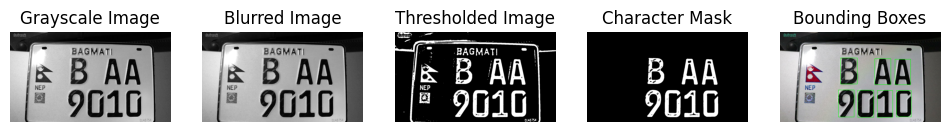

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import functools

# Bypass argparse and directly assign paths
args = {
    "image": r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\emb1.jpg"
}


# Read the image and convert to grayscale
image = cv2.imread(args["image"])
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blurring
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# Apply adaptive thresholding with modified parameters
thresh = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 35, 10
)

# Apply morphological operations to close small gaps
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

# Perform connected components analysis on the thresholded image
num_labels, labels = cv2.connectedComponents(thresh)

# Initialize the mask to hold only the components we are interested in
mask = np.zeros(thresh.shape, dtype="uint8")

# Set lower bound and upper bound criteria for characters
total_pixels = image.shape[0] * image.shape[1]
lower = total_pixels // 100  # More restrictive lower bound
upper = total_pixels // 25   # More restrictive upper bound

# Loop over the unique components
for (i, label) in enumerate(np.unique(labels)):
    # If this is the background label, ignore it
    if label == 0:
        continue

    # Construct the label mask to display only the connected component for the current label
    labelMask = np.zeros(thresh.shape, dtype="uint8")
    labelMask[labels == label] = 255
    numPixels = cv2.countNonZero(labelMask)

    # If the number of pixels in the component is between lower bound and upper bound, add it to our mask
    if numPixels > lower and numPixels < upper:
        mask = cv2.add(mask, labelMask)

# Find contours and get bounding box for each contour
cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
boundingBoxes = [cv2.boundingRect(c) for c in cnts]

# Sort the bounding boxes from left to right, top to bottom
def compare(rect1, rect2):
    if abs(rect1[1] - rect2[1]) > 10:
        return rect1[1] - rect2[1]
    else:
        return rect1[0] - rect2[0]

boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(compare))

# Display images using matplotlib
plt.figure(figsize=(12, 6))

# Display grayscale image
plt.subplot(1, 5, 1)
plt.imshow(gray, cmap="gray")
plt.title("Grayscale Image")
plt.axis("off")

# Display blurred image
plt.subplot(1, 5, 2)
plt.imshow(blurred, cmap="gray")
plt.title("Blurred Image")
plt.axis("off")

# Display thresholded image
plt.subplot(1, 5, 3)
plt.imshow(thresh, cmap="gray")
plt.title("Thresholded Image")
plt.axis("off")

# Display mask
plt.subplot(1, 5, 4)
plt.imshow(mask, cmap="gray")
plt.title("Character Mask")
plt.axis("off")

# Display bounding boxes overlay
overlay = image.copy()
for (x, y, w, h) in boundingBoxes:
    cv2.rectangle(overlay, (x, y), (x + w, y + h), (0, 255, 0), 2)

plt.subplot(1, 5, 5)
plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
plt.title("Bounding Boxes")
plt.axis("off")

plt.show()

In [3]:
import numpy as np
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import functools

# Load the model
model_path = r"C:\Users\Acer nitro 5\number\cnn\emb_model"
model = tf.keras.models.load_model(model_path)

# Define class names
class_names = [
    '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J',
    'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'
]

# Prediction function
def predict_character(image):
    img_height, img_width = 32, 32

    # Resize the grayscale character image to 32x32
    img = Image.fromarray(image).resize((img_height, img_width))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = np.repeat(img_array, 3, axis=-1) if img_array.shape[-1] == 1 else img_array
    img_array = np.expand_dims(img_array, 0)  # Add batch dimension

    # Perform prediction
    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    return class_names[np.argmax(score)], 100 * np.max(score), np.array(img)

# Updated segmentation and prediction
def find_and_predict_segments(image, threshold=50.0):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    thresh = cv2.adaptiveThreshold(
        blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 35, 10
    )

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    num_labels, labels = cv2.connectedComponents(thresh)

    total_pixels = image.shape[0] * image.shape[1]
    lower = total_pixels // 100
    upper = total_pixels // 25
    mask = np.zeros(thresh.shape, dtype="uint8")

    for label in np.unique(labels):
        if label == 0:
            continue
        labelMask = np.zeros(thresh.shape, dtype="uint8")
        labelMask[labels == label] = 255
        numPixels = cv2.countNonZero(labelMask)

        if lower < numPixels < upper:
            mask = cv2.add(mask, labelMask)

    cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boundingBoxes = [cv2.boundingRect(c) for c in cnts]
    boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(
        lambda rect1, rect2: rect1[1] - rect2[1] if abs(rect1[1] - rect2[1]) > 10 else rect1[0] - rect2[0]
    ))

    predictions = []
    for (x, y, w, h) in boundingBoxes:
        char_image = gray[y:y + h, x:x + w]
        label, confidence, processed_img = predict_character(char_image)
        if confidence >= threshold:
            predictions.append((label, confidence, processed_img))
    
    return predictions

# Display segmented characters with predictions
def display_segmented_characters(predictions):
    plt.figure(figsize=(20, 10))
    for idx, (label, confidence, char_image) in enumerate(predictions):
        plt.subplot(1, len(predictions), idx + 1)
        plt.imshow(char_image, cmap='gray')
        plt.title(f"{label} ({confidence:.2f}%)")
        plt.axis('off')
    plt.show()

# Load and process the image
image_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\emb1.jpg"
image = cv2.imread(image_path)

# Segment, predict, and filter characters
predictions = find_and_predict_segments(image)

# Display valid predictions with images
display_segmented_characters(predictions)

# Display predictions in text form
for idx, (label, confidence, _) in enumerate(predictions):
    print(f"Segment {idx + 1}: {label} with {confidence:.2f}% confidence")

ModuleNotFoundError: No module named 'tensorflow'

In [5]:
pip install tensorflow

Note: you may need to restart the kernel to use updated packages.


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


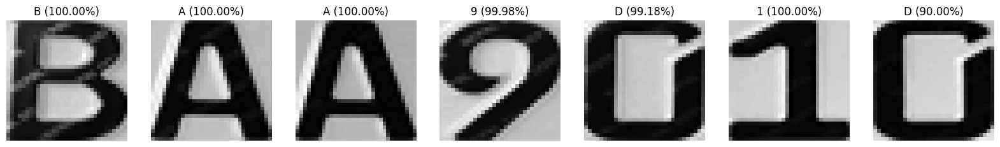

Segment 1: B with 100.00% confidence
Segment 2: A with 100.00% confidence
Segment 3: A with 100.00% confidence
Segment 4: 9 with 99.98% confidence
Segment 5: D with 99.18% confidence
Segment 6: 1 with 100.00% confidence
Segment 7: D with 90.00% confidence


In [2]:
import numpy as np
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import functools

# Load the model
model_path = r"C:\Users\Acer nitro 5\number\cnn\emb_model.h5"
model = tf.keras.models.load_model(model_path)

# Define class names
class_names = [
    '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J',
    'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'
]

# Prediction function
def predict_character(image):
    img_height, img_width = 32, 32

    # Resize the grayscale character image to 32x32
    img = Image.fromarray(image).resize((img_height, img_width))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = np.repeat(img_array, 3, axis=-1) if img_array.shape[-1] == 1 else img_array
    img_array = np.expand_dims(img_array, 0)  # Add batch dimension

    # Perform prediction
    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    return class_names[np.argmax(score)], 100 * np.max(score), np.array(img)

# Updated segmentation and prediction
def find_and_predict_segments(image, threshold=50.0):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    thresh = cv2.adaptiveThreshold(
        blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 35, 10
    )

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    num_labels, labels = cv2.connectedComponents(thresh)

    total_pixels = image.shape[0] * image.shape[1]
    lower = total_pixels // 100
    upper = total_pixels // 25
    mask = np.zeros(thresh.shape, dtype="uint8")

    for label in np.unique(labels):
        if label == 0:
            continue
        labelMask = np.zeros(thresh.shape, dtype="uint8")
        labelMask[labels == label] = 255
        numPixels = cv2.countNonZero(labelMask)

        if lower < numPixels < upper:
            mask = cv2.add(mask, labelMask)

    cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boundingBoxes = [cv2.boundingRect(c) for c in cnts]
    boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(
        lambda rect1, rect2: rect1[1] - rect2[1] if abs(rect1[1] - rect2[1]) > 10 else rect1[0] - rect2[0]
    ))

    predictions = []
    for (x, y, w, h) in boundingBoxes:
        char_image = gray[y:y + h, x:x + w]
        label, confidence, processed_img = predict_character(char_image)
        if confidence >= threshold:
            predictions.append((label, confidence, processed_img))
    
    return predictions

# Display segmented characters with predictions
def display_segmented_characters(predictions):
    plt.figure(figsize=(20, 10))
    for idx, (label, confidence, char_image) in enumerate(predictions):
        plt.subplot(1, len(predictions), idx + 1)
        plt.imshow(char_image, cmap='gray')
        plt.title(f"{label} ({confidence:.2f}%)")
        plt.axis('off')
    plt.show()

# Load and process the image
image_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\emb1.jpg"
image = cv2.imread(image_path)

# Segment, predict, and filter characters
predictions = find_and_predict_segments(image)

# Display valid predictions with images
display_segmented_characters(predictions)

# Display predictions in text form
for idx, (label, confidence, _) in enumerate(predictions):
    print(f"Segment {idx + 1}: {label} with {confidence:.2f}% confidence")

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


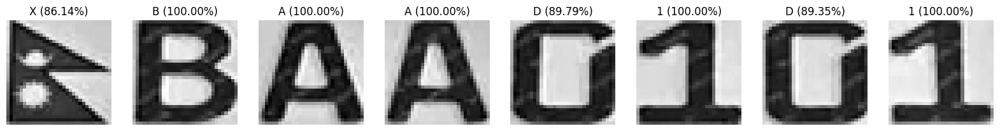

Segment 1: X with 86.14% confidence
Segment 2: B with 100.00% confidence
Segment 3: A with 100.00% confidence
Segment 4: A with 100.00% confidence
Segment 5: D with 89.79% confidence
Segment 6: 1 with 100.00% confidence
Segment 7: D with 89.35% confidence
Segment 8: 1 with 100.00% confidence


In [1]:
import numpy as np
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import functools

# Load the model
model_path = r"C:\Users\Acer nitro 5\number\cnn\emb_model.h5"
model = tf.keras.models.load_model(model_path)

# Define class names
class_names = [
    '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J',
    'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'
]

# Prediction function
def predict_character(image):
    img_height, img_width = 32, 32

    # Resize the grayscale character image to 32x32
    img = Image.fromarray(image).resize((img_height, img_width))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = np.repeat(img_array, 3, axis=-1) if img_array.shape[-1] == 1 else img_array
    img_array = np.expand_dims(img_array, 0)  # Add batch dimension

    # Perform prediction
    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    return class_names[np.argmax(score)], 100 * np.max(score), np.array(img)

# Updated segmentation and prediction
def find_and_predict_segments(image, threshold=50.0):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    thresh = cv2.adaptiveThreshold(
        blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 35, 10
    )

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    num_labels, labels = cv2.connectedComponents(thresh)

    total_pixels = image.shape[0] * image.shape[1]
    lower = total_pixels // 100
    upper = total_pixels // 25
    mask = np.zeros(thresh.shape, dtype="uint8")

    for label in np.unique(labels):
        if label == 0:
            continue
        labelMask = np.zeros(thresh.shape, dtype="uint8")
        labelMask[labels == label] = 255
        numPixels = cv2.countNonZero(labelMask)

        if lower < numPixels < upper:
            mask = cv2.add(mask, labelMask)

    cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boundingBoxes = [cv2.boundingRect(c) for c in cnts]
    boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(
        lambda rect1, rect2: rect1[1] - rect2[1] if abs(rect1[1] - rect2[1]) > 10 else rect1[0] - rect2[0]
    ))

    predictions = []
    for (x, y, w, h) in boundingBoxes:
        char_image = gray[y:y + h, x:x + w]
        label, confidence, processed_img = predict_character(char_image)
        if confidence >= threshold:
            predictions.append((label, confidence, processed_img))
    
    return predictions

# Display segmented characters with predictions
def display_segmented_characters(predictions):
    plt.figure(figsize=(20, 10))
    for idx, (label, confidence, char_image) in enumerate(predictions):
        plt.subplot(1, len(predictions), idx + 1)
        plt.imshow(char_image, cmap='gray')
        plt.title(f"{label} ({confidence:.2f}%)")
        plt.axis('off')
    plt.show()

# Load and process the image
image_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\emb2.png"
image = cv2.imread(image_path)

# Segment, predict, and filter characters
predictions = find_and_predict_segments(image)

# Display valid predictions with images
display_segmented_characters(predictions)

# Display predictions in text form
for idx, (label, confidence, _) in enumerate(predictions):
    print(f"Segment {idx + 1}: {label} with {confidence:.2f}% confidence")

In [2]:
import numpy as np
from PIL import Image
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import functools

# Load the model
model_path = r"C:\Users\Acer nitro 5\number\cnn\emb_model.h5"
model = tf.keras.models.load_model(model_path)

# Define class names
class_names = [
    '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J',
    'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'
]

# Prediction function
def predict_character(image):
    img_height, img_width = 32, 32

    # Resize the grayscale character image to 32x32
    img = Image.fromarray(image).resize((img_height, img_width))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = np.repeat(img_array, 3, axis=-1) if img_array.shape[-1] == 1 else img_array
    img_array = np.expand_dims(img_array, 0)  # Add batch dimension

    # Perform prediction
    predictions = model.predict(img_array)
    score = tf.nn.softmax(predictions[0])
    return class_names[np.argmax(score)], 100 * np.max(score), np.array(img)

# Updated segmentation and prediction
def find_and_predict_segments(image, threshold=50.0):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    thresh = cv2.adaptiveThreshold(
        blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 35, 10
    )

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    num_labels, labels = cv2.connectedComponents(thresh)

    total_pixels = image.shape[0] * image.shape[1]
    lower = total_pixels // 100
    upper = total_pixels // 25
    mask = np.zeros(thresh.shape, dtype="uint8")

    for label in np.unique(labels):
        if label == 0:
            continue
        labelMask = np.zeros(thresh.shape, dtype="uint8")
        labelMask[labels == label] = 255
        numPixels = cv2.countNonZero(labelMask)

        if lower < numPixels < upper:
            mask = cv2.add(mask, labelMask)

    cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    boundingBoxes = [cv2.boundingRect(c) for c in cnts]
    boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(
        lambda rect1, rect2: rect1[1] - rect2[1] if abs(rect1[1] - rect2[1]) > 10 else rect1[0] - rect2[0]
    ))

    predictions = []
    for (x, y, w, h) in boundingBoxes:
        char_image = gray[y:y + h, x:x + w]
        label, confidence, processed_img = predict_character(char_image)
        if confidence >= threshold:
            predictions.append((label, confidence, processed_img))
    
    return predictions

# Display segmented characters with predictions
def display_segmented_characters(predictions):
    plt.figure(figsize=(20, 10))
    for idx, (label, confidence, char_image) in enumerate(predictions):
        plt.subplot(1, len(predictions), idx + 1)
        plt.imshow(char_image, cmap='gray')
        plt.title(f"{label} ({confidence:.2f}%)")
        plt.axis('off')
    plt.show()

# Load and process the image
image_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\number_plate_20241111_141011_1.png"
image = cv2.imread(image_path)

# Segment, predict, and filter characters
predictions = find_and_predict_segments(image)

# Display valid predictions with images
display_segmented_characters(predictions)

# Display predictions in text form
for idx, (label, confidence, _) in enumerate(predictions):
    print(f"Segment {idx + 1}: {label} with {confidence:.2f}% confidence")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


<Figure size 2000x1000 with 0 Axes>

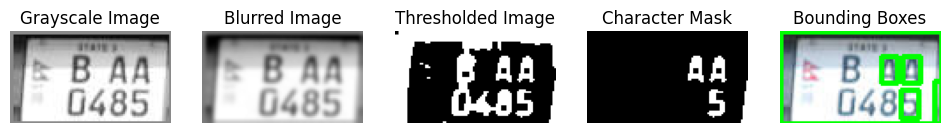

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import functools

# Bypass argparse and directly assign paths
args = {
    "image": r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\number_plate_20241119_181915_1.png"
}


# Read the image and convert to grayscale
image = cv2.imread(args["image"])
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Apply Gaussian blurring
blurred = cv2.GaussianBlur(gray, (5, 5), 0)

# Apply adaptive thresholding with modified parameters
thresh = cv2.adaptiveThreshold(
    blurred, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 35, 10
)

# Apply morphological operations to close small gaps
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

# Perform connected components analysis on the thresholded image
num_labels, labels = cv2.connectedComponents(thresh)

# Initialize the mask to hold only the components we are interested in
mask = np.zeros(thresh.shape, dtype="uint8")

# Set lower bound and upper bound criteria for characters
total_pixels = image.shape[0] * image.shape[1]
lower = total_pixels // 100  # More restrictive lower bound
upper = total_pixels // 25   # More restrictive upper bound

# Loop over the unique components
for (i, label) in enumerate(np.unique(labels)):
    # If this is the background label, ignore it
    if label == 0:
        continue

    # Construct the label mask to display only the connected component for the current label
    labelMask = np.zeros(thresh.shape, dtype="uint8")
    labelMask[labels == label] = 255
    numPixels = cv2.countNonZero(labelMask)

    # If the number of pixels in the component is between lower bound and upper bound, add it to our mask
    if numPixels > lower and numPixels < upper:
        mask = cv2.add(mask, labelMask)

# Find contours and get bounding box for each contour
cnts, _ = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
boundingBoxes = [cv2.boundingRect(c) for c in cnts]

# Sort the bounding boxes from left to right, top to bottom
def compare(rect1, rect2):
    if abs(rect1[1] - rect2[1]) > 10:
        return rect1[1] - rect2[1]
    else:
        return rect1[0] - rect2[0]

boundingBoxes = sorted(boundingBoxes, key=functools.cmp_to_key(compare))

# Display images using matplotlib
plt.figure(figsize=(12, 6))

# Display grayscale image
plt.subplot(1, 5, 1)
plt.imshow(gray, cmap="gray")
plt.title("Grayscale Image")
plt.axis("off")

# Display blurred image
plt.subplot(1, 5, 2)
plt.imshow(blurred, cmap="gray")
plt.title("Blurred Image")
plt.axis("off")

# Display thresholded image
plt.subplot(1, 5, 3)
plt.imshow(thresh, cmap="gray")
plt.title("Thresholded Image")
plt.axis("off")

# Display mask
plt.subplot(1, 5, 4)
plt.imshow(mask, cmap="gray")
plt.title("Character Mask")
plt.axis("off")

# Display bounding boxes overlay
overlay = image.copy()
for (x, y, w, h) in boundingBoxes:
    cv2.rectangle(overlay, (x, y), (x + w, y + h), (0, 255, 0), 2)

plt.subplot(1, 5, 5)
plt.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))
plt.title("Bounding Boxes")
plt.axis("off")

plt.show()

Processing the image ....

0: 448x640 1 number plate, 271.2ms
Speed: 294.0ms preprocess, 271.2ms inference, 1976.0ms postprocess per image at shape (1, 3, 448, 640)
1 Number plate(s) have been detected.
Cropped image saved as: C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\number_plate_20241119_181915_1.png


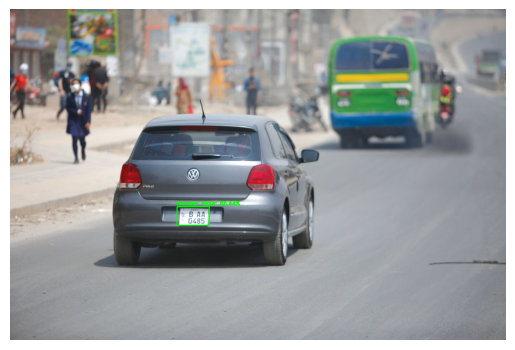

Time to detect and crop number plate: 15818.08 milliseconds


In [1]:
import os
import cv2
import torch
import time
import matplotlib.pyplot as plt
from ultralytics import YOLO
from datetime import datetime

# Constants
CONFIDENCE_THRESHOLD = 0.6
COLOR = (0, 255, 0)
CROP_SAVE_PATH = r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped"  # Path to save cropped images

# Create cropped folder if it doesn't exist
if not os.path.exists(CROP_SAVE_PATH):
    os.makedirs(CROP_SAVE_PATH)

def detect_and_crop_number_plate(image, model, display=False):
    start = time.time()
    detections = model.predict(image)[0].boxes.data

    if detections.shape != torch.Size([0, 6]):
        boxes = []
        confidences = []

        # Loop through detections and filter by confidence
        for detection in detections:
            confidence = detection[4]
            if float(confidence) < CONFIDENCE_THRESHOLD:
                continue
            boxes.append(detection[:4])
            confidences.append(detection[4])

        print(f"{len(boxes)} Number plate(s) have been detected.")
        number_plate_list = []

        for i in range(len(boxes)):
            xmin, ymin, xmax, ymax = int(boxes[i][0]), int(boxes[i][1]), int(boxes[i][2]), int(boxes[i][3])
            number_plate_list.append([xmin, ymin, xmax, ymax])

            # Draw rectangle and label confidence
            cv2.rectangle(image, (xmin, ymin), (xmax, ymax), COLOR, 2)
            text = "Number Plate: {:.2f}%".format(confidences[i] * 100)
            cv2.putText(image, text, (xmin, ymin - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, COLOR, 2)

            # Crop the detected number plate (preserve quality)
            cropped_image = image[ymin:ymax, xmin:xmax].copy()

            # Save the cropped image without compression
            timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
            cropped_filename = os.path.join(CROP_SAVE_PATH, f"number_plate_{timestamp}_{i+1}.png")
            cv2.imwrite(cropped_filename, cropped_image, [cv2.IMWRITE_PNG_COMPRESSION, 0])
            print(f"Cropped image saved as: {cropped_filename}")

        # Optionally display the image with bounding box
        if display:
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.axis('off')  # Turn off axis for cleaner display
            plt.show()

        end = time.time()
        print(f"Time to detect and crop number plate: {(end - start) * 1000:.2f} milliseconds")

        return number_plate_list
    else:
        print("No number plate has been detected")
        return []

if __name__ == "__main__":
    model = YOLO("C:\\Users\\Acer nitro 5\\number\\code\\runs\\detect\\train2\\weights\\best.pt")
    file_path = "C:\\Users\\Acer nitro 5\\number\\datasets\\test\\test2.jpg"

    _, file_extension = os.path.splitext(file_path)

    if file_extension in [".jpg", ".jpeg", ".png"]:
        print("Processing the image ....")
        image = cv2.imread(file_path)
        
        # Call the function to detect and crop the number plate
        detect_and_crop_number_plate(image, model, display=True)


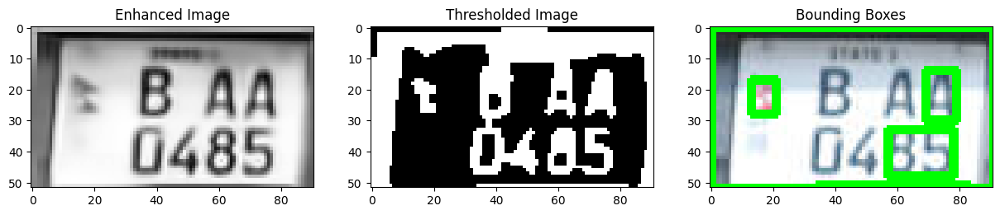

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
image_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\cropped\\number_plate_20241119_181915_1.png"
image = cv2.imread(image_path)

# Enhance image clarity using CLAHE
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
gray = clahe.apply(gray)

# Advanced denoising
gray = cv2.fastNlMeansDenoising(gray, None, h=30, templateWindowSize=7, searchWindowSize=21)

# Adaptive and Otsu thresholding
adaptive_thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 31, 8)
_, otsu_thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
thresh = cv2.bitwise_or(adaptive_thresh, otsu_thresh)

# Dynamic morphological operations
height, width = gray.shape
kernel_size = (max(3, width // 100), max(3, height // 100))
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernel_size)
thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

# Connected components analysis
num_labels, labels = cv2.connectedComponents(thresh)

# Initialize mask for valid components
mask = np.zeros(thresh.shape, dtype="uint8")
total_pixels = gray.shape[0] * gray.shape[1]
lower = total_pixels // 500
upper = total_pixels // 20

# Filter connected components
for label in np.unique(labels):
    if label == 0:
        continue
    labelMask = np.zeros(thresh.shape, dtype="uint8")
    labelMask[labels == label] = 255
    numPixels = cv2.countNonZero(labelMask)
    if lower < numPixels < upper:
        mask = cv2.add(mask, labelMask)

# Find and filter contours
cnts, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
boundingBoxes = [cv2.boundingRect(c) for c in cnts]

# Display images
plt.figure(figsize=(15, 8))
plt.subplot(1, 3, 1), plt.imshow(gray, cmap="gray"), plt.title("Enhanced Image")
plt.subplot(1, 3, 2), plt.imshow(thresh, cmap="gray"), plt.title("Thresholded Image")
plt.subplot(1, 3, 3)
for (x, y, w, h) in boundingBoxes:
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title("Bounding Boxes")
plt.show()


In [8]:
pip install realesrgan


  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
   ---------------------------------------- 0.0/2.7 MB ? eta -:--:--
   --- ------------------------------------ 0.3/2.7 MB ? eta -:--:--
   ------- -------------------------------- 0.5/2.7 MB 1.5 MB/s eta 0:00:02
   ----------- ---------------------------- 0.8/2.7 MB 1.5 MB/s eta 0:00:02
   ------------------- -------------------- 1.3/2.7 MB 1.6 MB/s eta 0:00:01
   ----------------------- ---------------- 1.6/2.7 MB 1.6 MB/s eta 0:00:01
   --------------------------- ------------ 1.8/2.7 MB 1.5 MB/s eta 0:00:01
   ------------------------------- -------- 2.1/2.7 MB 1.5 MB/s eta 0:00:01
   ---------------------------------------  2.6/2.7 MB 1.5 MB/s eta 0:00:01
   ---------------------------------------- 2.7/2.7 MB 1.5 MB/s eta 0:00:00
   ---------------------------------------- 0.0/12

In [2]:
import cv2
print(cv2.__version__)


4.10.0


In [3]:
pip uninstall opencv-python opencv-contrib-python opencv-python-headless -y


Found existing installation: opencv-python 4.10.0.84
Uninstalling opencv-python-4.10.0.84:
  Successfully uninstalled opencv-python-4.10.0.84
Found existing installation: opencv-python-headless 4.10.0.84
Uninstalling opencv-python-headless-4.10.0.84:
  Successfully uninstalled opencv-python-headless-4.10.0.84
Note: you may need to restart the kernel to use updated packages.


You can safely remove it manually.


In [4]:
pip install opencv-contrib-python


   ---------------------------------------- 0.0/45.5 MB ? eta -:--:--
   ---------------------------------------- 0.0/45.5 MB ? eta -:--:--
   ---------------------------------------- 0.3/45.5 MB ? eta -:--:--
   ---------------------------------------- 0.3/45.5 MB ? eta -:--:--
   ---------------------------------------- 0.5/45.5 MB 699.0 kB/s eta 0:01:05
   ---------------------------------------- 0.5/45.5 MB 699.0 kB/s eta 0:01:05
    --------------------------------------- 0.8/45.5 MB 699.0 kB/s eta 0:01:05
    --------------------------------------- 1.0/45.5 MB 709.1 kB/s eta 0:01:03
    --------------------------------------- 1.0/45.5 MB 709.1 kB/s eta 0:01:03
   - -------------------------------------- 1.3/45.5 MB 713.8 kB/s eta 0:01:02
   - -------------------------------------- 1.3/45.5 MB 713.8 kB/s eta 0:01:02
   - -------------------------------------- 1.6/45.5 MB 710.8 kB/s eta 0:01:02
   - -------------------------------------- 1.8/45.5 MB 714.0 kB/s eta 0:01:02
   - ----

# Video

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
from ultralytics import YOLO

# Load the YOLO models
plate_detection_model_path = ("C:\\Users\\Acer nitro 5\\number\\code\\runs\\detect\\train2\\weights\\best.pt")
plate_detection_model = YOLO(plate_detection_model_path)  # License plate detection model

character_segmentation_model_path = r"C:\\Users\\Acer nitro 5\\number\seg\runs\detect\train\weights\best.pt"
character_segmentation_model = YOLO(character_segmentation_model_path)  # Character segmentation model

# Load the classification model
classification_model_path = r"C:\Users\Acer nitro 5\number\cnn\emb_model.h5"
classification_model = tf.keras.models.load_model(classification_model_path)

# Define class names
class_names = [
    '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J',
    'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'
]

# Prediction function for classification
def predict_character(image):
    img_height, img_width = 32, 32

    # Resize the grayscale character image to 32x32
    img = Image.fromarray(image).resize((img_height, img_width))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = np.expand_dims(img_array, 0)  # Add batch dimension

    # Perform prediction
    predictions = classification_model.predict(img_array, verbose=0)
    score = tf.nn.softmax(predictions[0])
    return class_names[np.argmax(score)], 100 * np.max(score)

# Use the YOLO model for character segmentation
def find_and_predict_segments_with_yolo(image, segmentation_model, threshold=50.0):
    results = segmentation_model.predict(source=image, save=False, imgsz=640)
    predictions = []

    # Loop through the detected bounding boxes
    for result in results:
        for bbox in result.boxes.xyxy:
            x1, y1, x2, y2 = map(int, bbox)  # Extract bounding box coordinates
            char_image = image[y1:y2, x1:x2]  # Crop the character from the image

            # Predict the character using the classification model
            if char_image.size > 0:  # Ensure bounding box is valid
                label, confidence = predict_character(char_image)
                if confidence >= threshold:
                    predictions.append((label, confidence, (x1, y1, x2, y2)))

    return predictions

# Process video frame by frame
def process_video(video_path, plate_model, char_segmentation_model):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    while True:
        ret, frame = cap.read()
        if not ret:
            break  # Exit loop if no frame is returned

        # Detect license plates in the frame
        plate_results = plate_model.predict(source=frame, save=False, imgsz=640)

        for plate_result in plate_results:
            for plate_bbox in plate_result.boxes.xyxy:
                x1, y1, x2, y2 = map(int, plate_bbox)  # Extract license plate bounding box
                plate_image = frame[y1:y2, x1:x2]  # Crop the license plate region

                # Perform character segmentation and recognition on the license plate
                predictions = find_and_predict_segments_with_yolo(plate_image, char_segmentation_model)

                # Combine recognized characters into a single string
                plate_text = ''.join([label for label, confidence, _ in predictions])

                # Draw the license plate bounding box on the frame
                cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0, 0), 2)  # License plate box

                # Draw the recognized license plate text above the bounding box
                text_position = (x1, y1 - 10)  # Position slightly above the plate box
                cv2.putText(
                    frame,
                    plate_text,
                    text_position,
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.8,  # Font size
                    (255, 255, 255),  # Font color (white)
                    2  # Thickness
                )

        # Display the processed frame
        cv2.imshow("Video Frame", frame)

        # Break the loop on 'q' key press
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

# Video path
video_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\video\\vid2.mp4"

# Process the video
process_video(video_path, plate_detection_model, character_segmentation_model)


0: 640x384 1 number plate, 124.0ms
Speed: 127.6ms preprocess, 124.0ms inference, 88.6ms postprocess per image at shape (1, 3, 640, 384)

0: 448x640 7 characters, 55.6ms
Speed: 3.6ms preprocess, 55.6ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)

0: 640x384 1 number plate, 42.3ms
Speed: 6.3ms preprocess, 42.3ms inference, 8.0ms postprocess per image at shape (1, 3, 640, 384)

0: 480x640 8 characters, 100.4ms
Speed: 5.1ms preprocess, 100.4ms inference, 4.1ms postprocess per image at shape (1, 3, 480, 640)

0: 640x384 1 number plate, 21.7ms
Speed: 4.0ms preprocess, 21.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 384)

0: 448x640 7 characters, 30.9ms
Speed: 3.5ms preprocess, 30.9ms inference, 5.0ms postprocess per image at shape (1, 3, 448, 640)

0: 640x384 1 number plate, 21.9ms
Speed: 3.5ms preprocess, 21.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)

0: 480x640 7 characters, 27.4ms
Speed: 3.4ms preprocess, 27.4ms inference,

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
from ultralytics import YOLO

# Load the YOLO models
plate_detection_model_path = ("C:\\Users\\Acer nitro 5\\number\\code\\runs\\detect\\train2\\weights\\best.pt")
plate_detection_model = YOLO(plate_detection_model_path)  # License plate detection model

character_segmentation_model_path = r"C:\\Users\\Acer nitro 5\\number\seg\runs\detect\train\weights\best.pt"
character_segmentation_model = YOLO(character_segmentation_model_path)  # Character segmentation model

# Load the classification model
classification_model_path = r"C:\Users\Acer nitro 5\number\cnn\emb_model.h5"
classification_model = tf.keras.models.load_model(classification_model_path)

# Define class names
class_names = [
    '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J',
    'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'
]

# Prediction function for classification
def predict_character(image):
    img_height, img_width = 32, 32

    # Resize the grayscale character image to 32x32
    img = Image.fromarray(image).resize((img_height, img_width))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = np.expand_dims(img_array, 0)  # Add batch dimension

    # Perform prediction
    predictions = classification_model.predict(img_array, verbose=0)
    score = tf.nn.softmax(predictions[0])
    return class_names[np.argmax(score)]

# Use the YOLO model for character segmentation
def find_and_predict_segments_with_yolo(image, segmentation_model, threshold=50.0):
    results = segmentation_model.predict(source=image, save=False, imgsz=320)
    predictions = []

    # Loop through the detected bounding boxes
    for result in results:
        for bbox in result.boxes.xyxy:
            x1, y1, x2, y2 = map(int, bbox)  # Extract bounding box coordinates
            char_image = image[y1:y2, x1:x2]  # Crop the character from the image

            # Predict the character using the classification model
            if char_image.size > 0:  # Ensure bounding box is valid
                label = predict_character(char_image)
                predictions.append((label, (x1, y1, x2, y2)))

    return predictions

# Process video frame by frame
# Process video frame by frame with adjustable speed
def process_video(video_path, plate_model, char_segmentation_model, playback_speed=2.0):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    delay = int(1000 / (60 * playback_speed))  # Adjust delay based on playback speed (30 FPS assumed)

    while True:
        ret, frame = cap.read()
        if not ret:
            break  # Exit loop if no frame is returned

        # Detect license plates in the frame
        plate_results = plate_model.predict(source=frame, save=False, imgsz=640)

        for plate_result in plate_results:
            for plate_bbox in plate_result.boxes.xyxy:
                x1, y1, x2, y2 = map(int, plate_bbox)  # Extract license plate bounding box
                plate_image = frame[y1:y2, x1:x2]  # Crop the license plate region

                # Perform character segmentation and recognition on the license plate
                predictions = find_and_predict_segments_with_yolo(plate_image, char_segmentation_model)

                # Draw the license plate bounding box on the frame
                cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0, 0), 2)  # License plate box

                # Determine the middle of the license plate
                plate_middle = y1 + (y2 - y1) // 2

                # Draw each character bounding box and label
                for label, (cx1, cy1, cx2, cy2) in predictions:
                    # Adjust coordinates relative to the full frame
                    global_x1, global_y1, global_x2, global_y2 = x1 + cx1, y1 + cy1, x1 + cx2, y1 + cy2

                    # Draw character bounding box
                    cv2.rectangle(frame, (global_x1, global_y1), (global_x2, global_y2), (0, 255, 0), 2)  # Character box

                    # Determine whether the character is in the upper or lower half
                    if global_y1 < plate_middle:
                        # Upper row: display label above the character box
                        label_position = (global_x1, global_y1 - 10)  # Slightly above the character box
                    else:
                        # Lower row: display label below the character box
                        label_position = (global_x1, global_y2 + 20)  # Slightly below the character box

                    # Draw character label
                    cv2.putText(
                        frame,
                        label,
                        label_position,
                        cv2.FONT_HERSHEY_SIMPLEX,
                        0.5,
                        (0, 255, 0),  # Green color for text
                        2
                    )

        # Display the processed frame
        cv2.imshow("Video Frame", frame)

        # Break the loop on 'q' key press
        if cv2.waitKey(delay) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()


# Video path
video_path = r"C:\\Users\\Acer nitro 5\\number\\datasets\\video\\vid2.mp4"

# Adjust playback speed: 1.0 = normal, >1.0 = faster, <1.0 = slower
playback_speed = 3  # Example: Play at 1.5x speed

# Process the video
process_video(video_path, plate_detection_model, character_segmentation_model, playback_speed=playback_speed)


0: 640x384 1 number plate, 11.3ms
Speed: 2.1ms preprocess, 11.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)

0: 224x320 7 characters, 61.6ms
Speed: 1.4ms preprocess, 61.6ms inference, 3.1ms postprocess per image at shape (1, 3, 224, 320)

0: 640x384 1 number plate, 13.8ms
Speed: 3.3ms preprocess, 13.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)

0: 256x320 7 characters, 64.5ms
Speed: 2.1ms preprocess, 64.5ms inference, 2.4ms postprocess per image at shape (1, 3, 256, 320)

0: 640x384 1 number plate, 12.2ms
Speed: 2.3ms preprocess, 12.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)

0: 224x320 8 characters, 14.6ms
Speed: 1.1ms preprocess, 14.6ms inference, 3.1ms postprocess per image at shape (1, 3, 224, 320)

0: 640x384 1 number plate, 43.4ms
Speed: 5.2ms preprocess, 43.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 384)

0: 256x320 7 characters, 22.8ms
Speed: 1.5ms preprocess, 22.8ms inference, 2.1ms 


0: 640x384 1 number plate, 12.3ms
Speed: 3.1ms preprocess, 12.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)


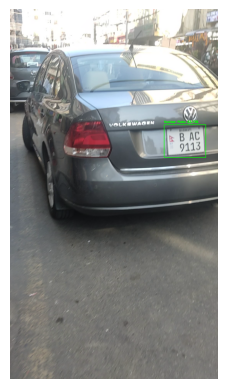


0: 640x384 1 number plate, 12.7ms
Speed: 3.7ms preprocess, 12.7ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 384)


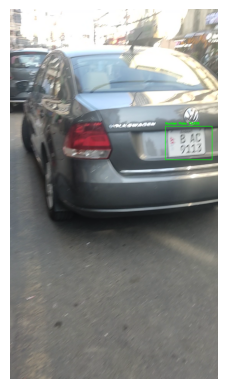


0: 640x384 1 number plate, 13.6ms
Speed: 2.5ms preprocess, 13.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)


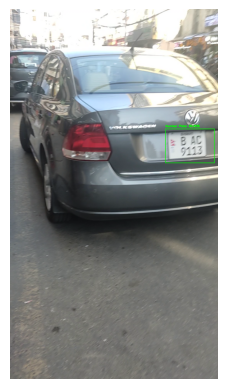


0: 640x384 1 number plate, 11.2ms
Speed: 3.2ms preprocess, 11.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


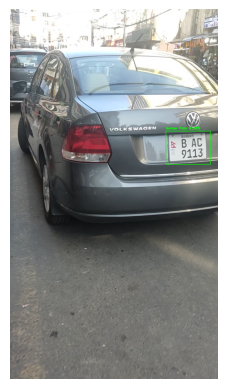


0: 640x384 1 number plate, 22.2ms
Speed: 3.0ms preprocess, 22.2ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 384)


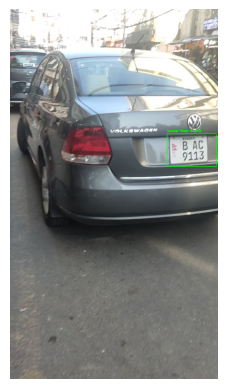


0: 640x384 1 number plate, 11.1ms
Speed: 4.0ms preprocess, 11.1ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 384)


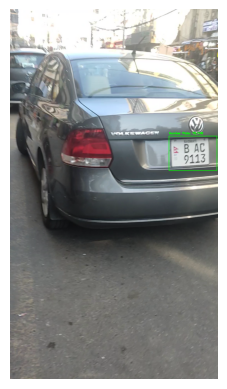


0: 640x384 1 number plate, 44.9ms
Speed: 4.0ms preprocess, 44.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 384)


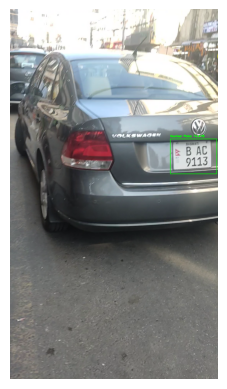


0: 640x384 1 number plate, 45.9ms
Speed: 5.0ms preprocess, 45.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


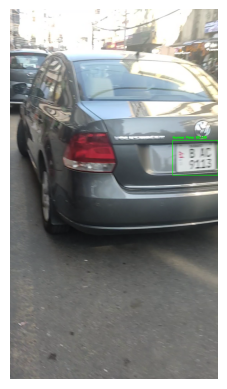


0: 640x384 1 number plate, 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)


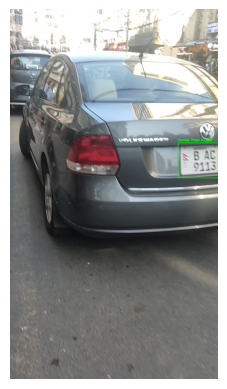


0: 640x384 1 number plate, 45.6ms
Speed: 5.0ms preprocess, 45.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


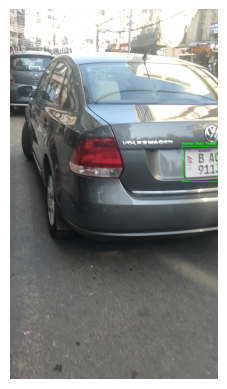


0: 640x384 (no detections), 46.1ms
Speed: 5.0ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


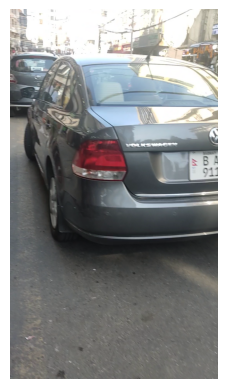


0: 640x384 (no detections), 49.9ms
Speed: 8.3ms preprocess, 49.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


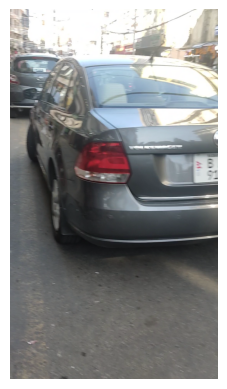


0: 640x384 (no detections), 46.3ms
Speed: 4.9ms preprocess, 46.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


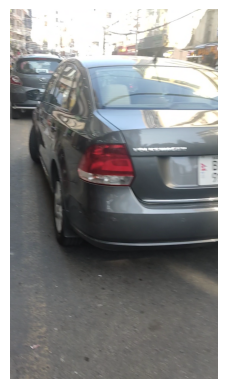


0: 640x384 (no detections), 45.2ms
Speed: 4.6ms preprocess, 45.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


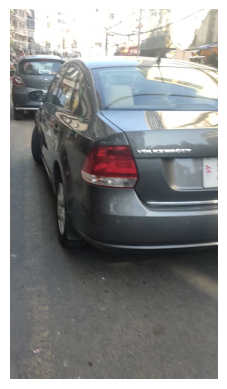


0: 640x384 (no detections), 46.1ms
Speed: 5.2ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


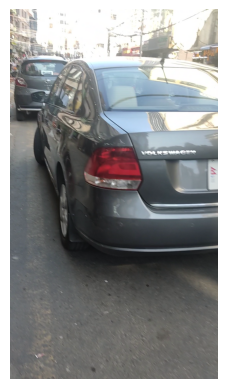


0: 640x384 (no detections), 45.8ms
Speed: 5.0ms preprocess, 45.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


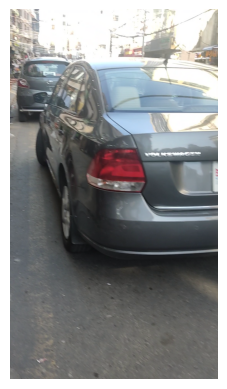


0: 640x384 (no detections), 46.1ms
Speed: 3.4ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


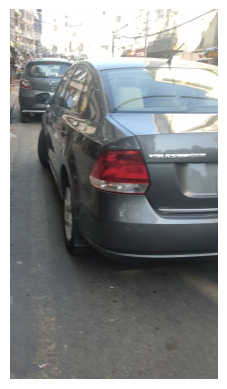


0: 640x384 (no detections), 45.7ms
Speed: 5.2ms preprocess, 45.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


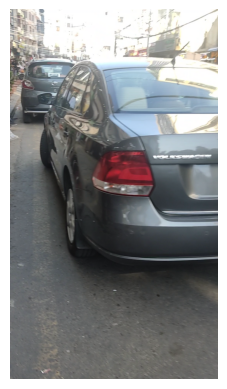


0: 640x384 (no detections), 46.3ms
Speed: 4.2ms preprocess, 46.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


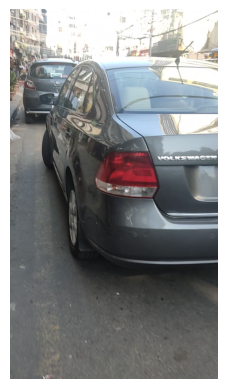


0: 640x384 (no detections), 45.2ms
Speed: 5.0ms preprocess, 45.2ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


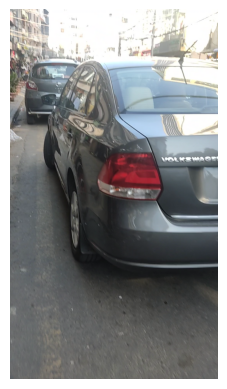


0: 640x384 (no detections), 46.5ms
Speed: 4.2ms preprocess, 46.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)


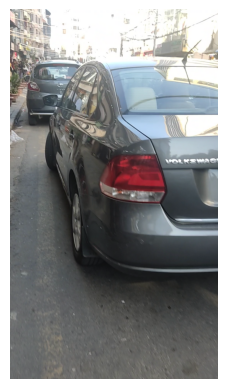


0: 640x384 (no detections), 45.2ms
Speed: 5.0ms preprocess, 45.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)


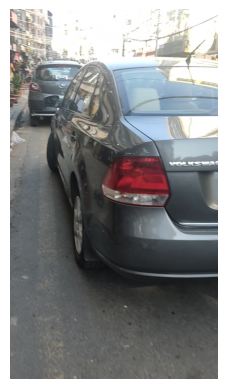


0: 640x384 (no detections), 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


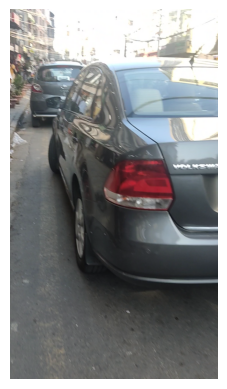


0: 640x384 (no detections), 45.6ms
Speed: 5.3ms preprocess, 45.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


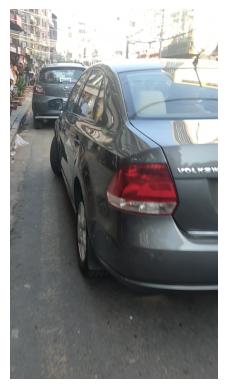


0: 640x384 (no detections), 46.3ms
Speed: 4.1ms preprocess, 46.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)


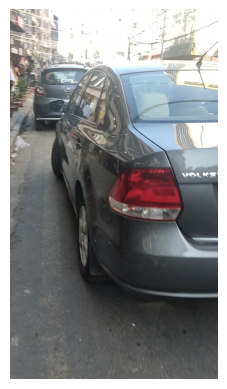


0: 640x384 (no detections), 45.8ms
Speed: 9.7ms preprocess, 45.8ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 384)


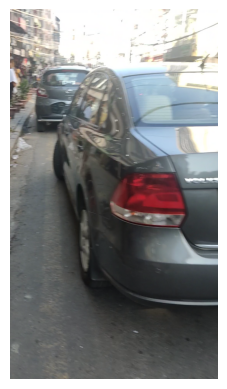


0: 640x384 (no detections), 45.0ms
Speed: 4.2ms preprocess, 45.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)


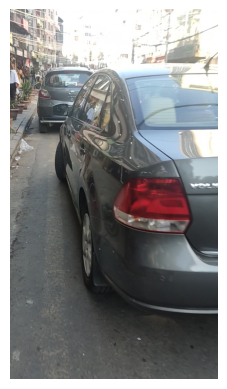


0: 640x384 (no detections), 46.5ms
Speed: 4.2ms preprocess, 46.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


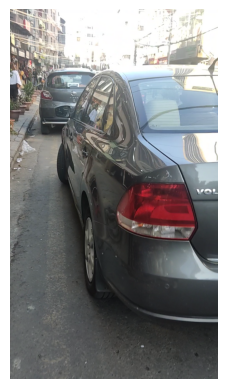


0: 640x384 (no detections), 45.5ms
Speed: 5.3ms preprocess, 45.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


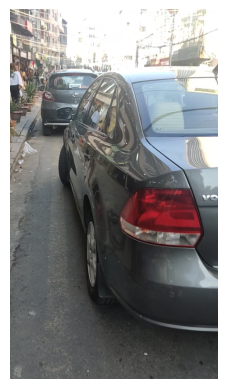


0: 640x384 (no detections), 46.1ms
Speed: 4.4ms preprocess, 46.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


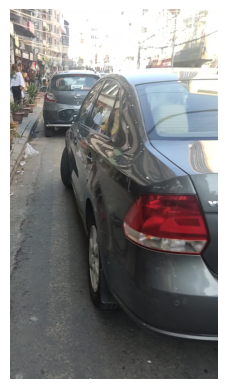


0: 640x384 (no detections), 45.1ms
Speed: 5.4ms preprocess, 45.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


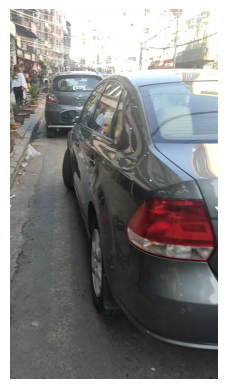


0: 640x384 (no detections), 45.5ms
Speed: 5.3ms preprocess, 45.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


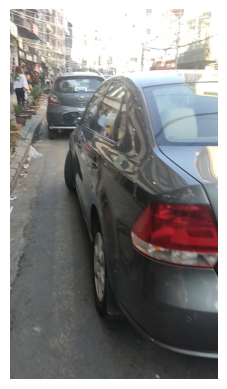


0: 640x384 (no detections), 46.0ms
Speed: 4.0ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


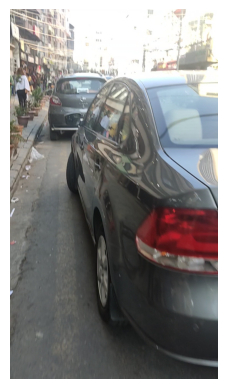


0: 640x384 (no detections), 46.5ms
Speed: 4.7ms preprocess, 46.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


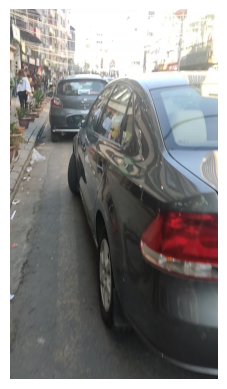


0: 640x384 (no detections), 46.0ms
Speed: 5.6ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


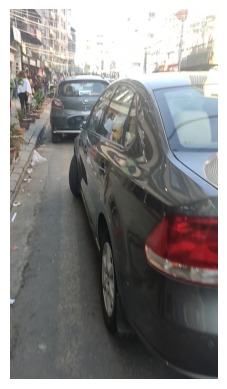


0: 640x384 (no detections), 45.3ms
Speed: 4.4ms preprocess, 45.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


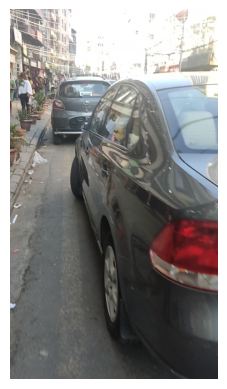


0: 640x384 (no detections), 46.6ms
Speed: 4.4ms preprocess, 46.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


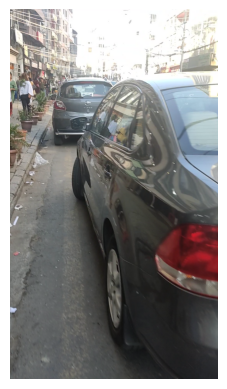


0: 640x384 (no detections), 45.4ms
Speed: 5.3ms preprocess, 45.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


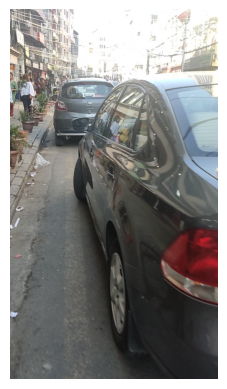


0: 640x384 (no detections), 45.4ms
Speed: 4.4ms preprocess, 45.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


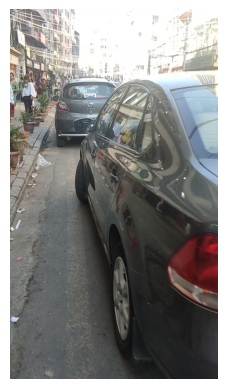


0: 640x384 (no detections), 45.5ms
Speed: 4.1ms preprocess, 45.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


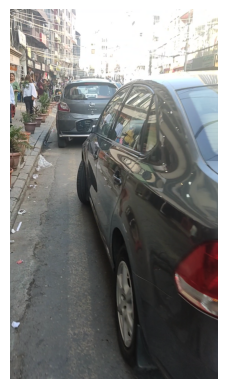


0: 640x384 (no detections), 45.8ms
Speed: 4.2ms preprocess, 45.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


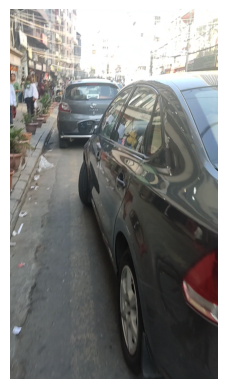


0: 640x384 (no detections), 45.6ms
Speed: 4.0ms preprocess, 45.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


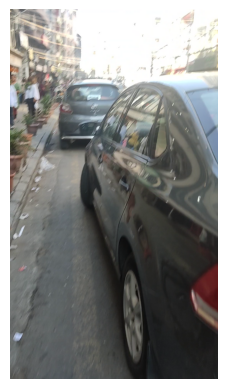


0: 640x384 (no detections), 46.6ms
Speed: 3.6ms preprocess, 46.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


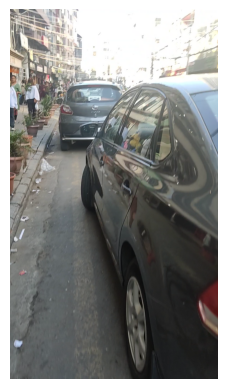


0: 640x384 (no detections), 45.8ms
Speed: 4.3ms preprocess, 45.8ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


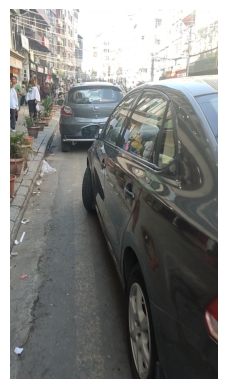


0: 640x384 (no detections), 46.4ms
Speed: 4.0ms preprocess, 46.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


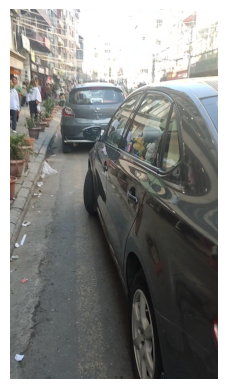


0: 640x384 (no detections), 46.0ms
Speed: 3.5ms preprocess, 46.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


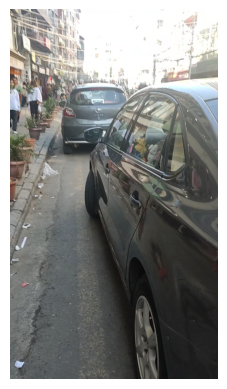


0: 640x384 (no detections), 46.3ms
Speed: 5.0ms preprocess, 46.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)


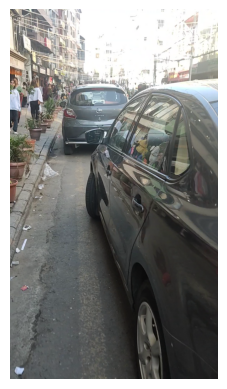


0: 640x384 (no detections), 46.2ms
Speed: 5.3ms preprocess, 46.2ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 384)


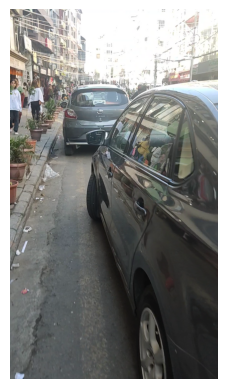


0: 640x384 (no detections), 46.5ms
Speed: 4.6ms preprocess, 46.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


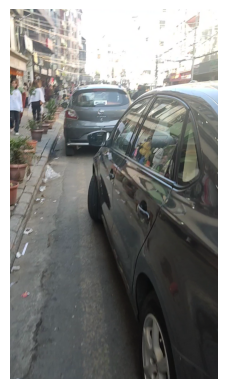


0: 640x384 (no detections), 45.8ms
Speed: 4.0ms preprocess, 45.8ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


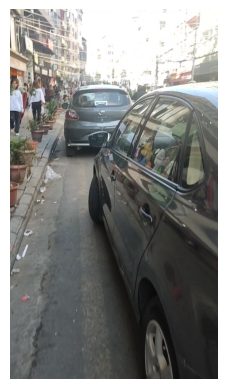


0: 640x384 (no detections), 46.2ms
Speed: 4.2ms preprocess, 46.2ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


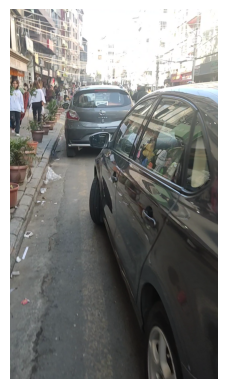


0: 640x384 (no detections), 46.3ms
Speed: 4.2ms preprocess, 46.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


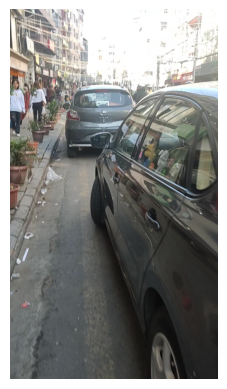


0: 640x384 (no detections), 45.9ms
Speed: 4.3ms preprocess, 45.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


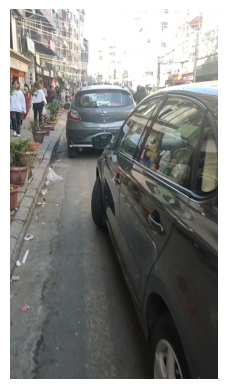


0: 640x384 (no detections), 46.1ms
Speed: 4.2ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


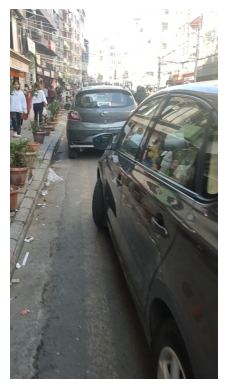


0: 640x384 (no detections), 46.7ms
Speed: 6.0ms preprocess, 46.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)


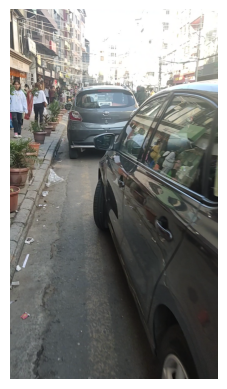


0: 640x384 (no detections), 46.0ms
Speed: 4.1ms preprocess, 46.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


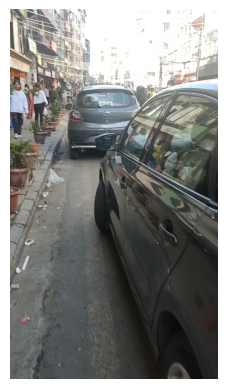


0: 640x384 (no detections), 45.4ms
Speed: 5.7ms preprocess, 45.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


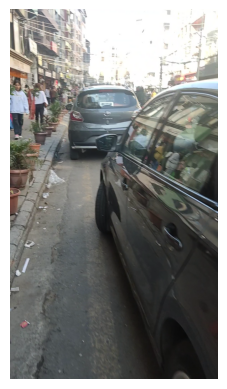


0: 640x384 (no detections), 45.7ms
Speed: 4.3ms preprocess, 45.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)


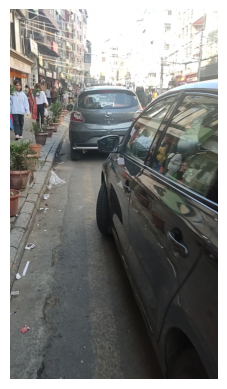


0: 640x384 (no detections), 45.3ms
Speed: 5.3ms preprocess, 45.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 384)


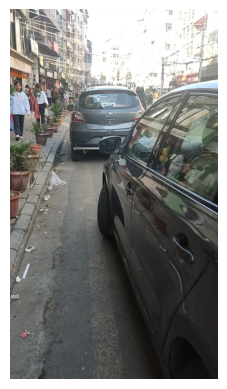


0: 640x384 (no detections), 46.3ms
Speed: 3.5ms preprocess, 46.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


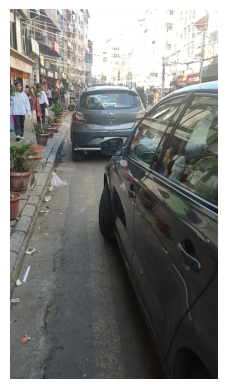


0: 640x384 (no detections), 46.5ms
Speed: 9.8ms preprocess, 46.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


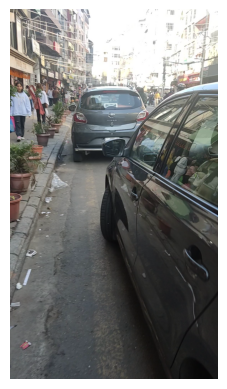


0: 640x384 (no detections), 46.2ms
Speed: 7.0ms preprocess, 46.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


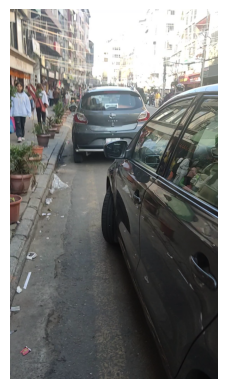


0: 640x384 (no detections), 45.7ms
Speed: 3.7ms preprocess, 45.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


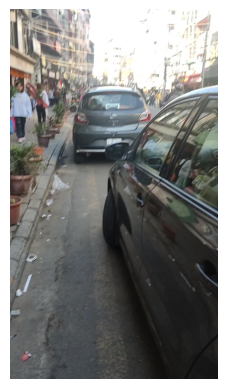


0: 640x384 (no detections), 46.0ms
Speed: 5.6ms preprocess, 46.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


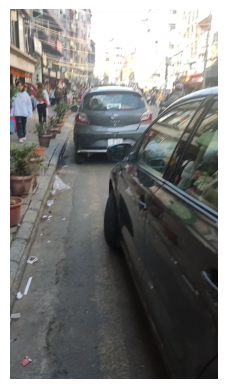


0: 640x384 (no detections), 46.0ms
Speed: 7.2ms preprocess, 46.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


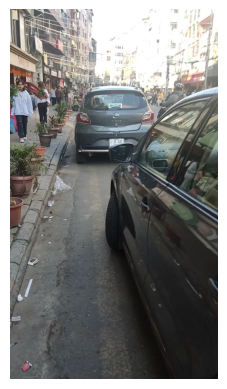


0: 640x384 (no detections), 46.3ms
Speed: 4.0ms preprocess, 46.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


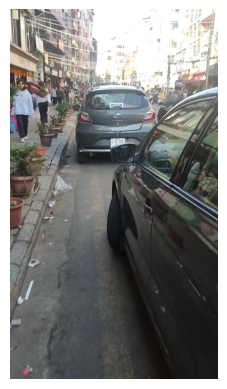


0: 640x384 1 number plate, 46.3ms
Speed: 4.8ms preprocess, 46.3ms inference, 31.3ms postprocess per image at shape (1, 3, 640, 384)


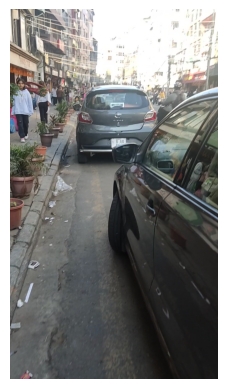


0: 640x384 (no detections), 45.7ms
Speed: 5.0ms preprocess, 45.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


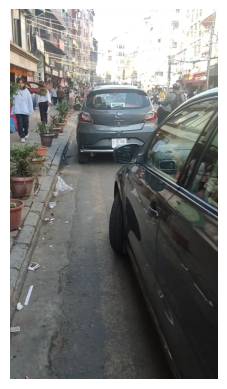


0: 640x384 (no detections), 45.5ms
Speed: 4.6ms preprocess, 45.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


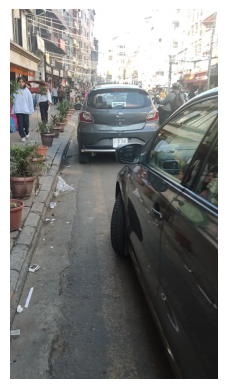


0: 640x384 (no detections), 45.8ms
Speed: 4.3ms preprocess, 45.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


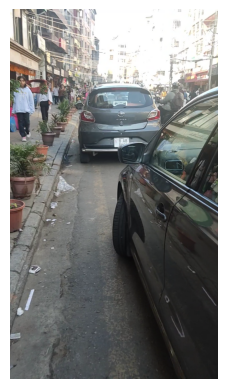


0: 640x384 (no detections), 45.7ms
Speed: 9.2ms preprocess, 45.7ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 384)


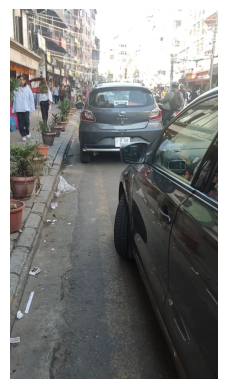


0: 640x384 (no detections), 45.9ms
Speed: 4.5ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


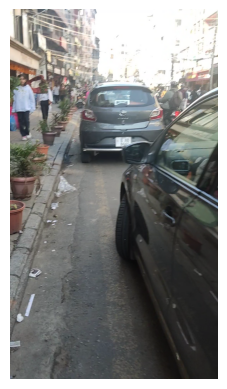


0: 640x384 1 number plate, 45.6ms
Speed: 5.0ms preprocess, 45.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)


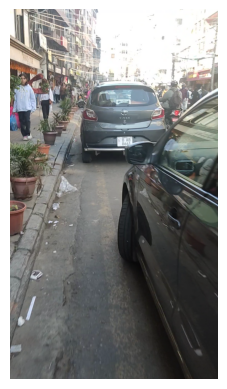


0: 640x384 1 number plate, 45.0ms
Speed: 5.6ms preprocess, 45.0ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 384)


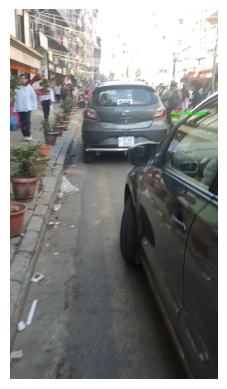


0: 640x384 (no detections), 46.6ms
Speed: 4.0ms preprocess, 46.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


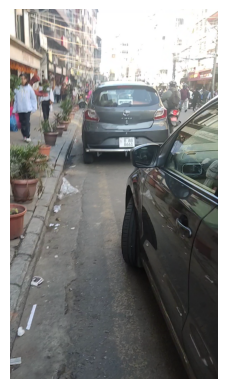


0: 640x384 (no detections), 46.2ms
Speed: 4.5ms preprocess, 46.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


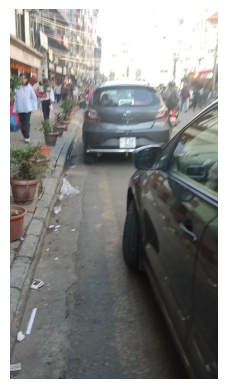


0: 640x384 (no detections), 45.2ms
Speed: 4.0ms preprocess, 45.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


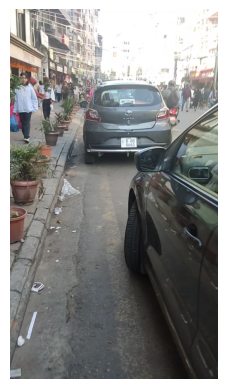


0: 640x384 (no detections), 45.9ms
Speed: 4.1ms preprocess, 45.9ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 384)


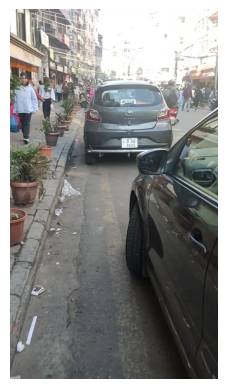


0: 640x384 (no detections), 46.3ms
Speed: 4.0ms preprocess, 46.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


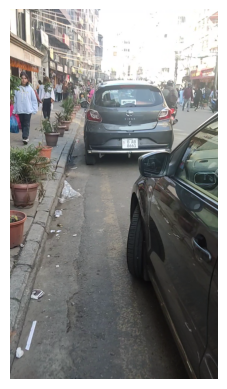


0: 640x384 (no detections), 46.4ms
Speed: 5.0ms preprocess, 46.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


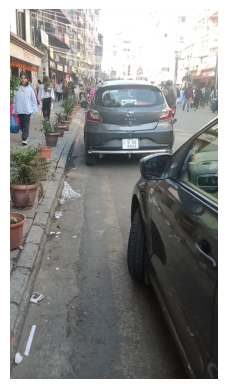


0: 640x384 (no detections), 45.9ms
Speed: 5.4ms preprocess, 45.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


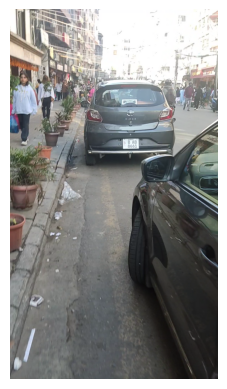


0: 640x384 (no detections), 46.2ms
Speed: 4.2ms preprocess, 46.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


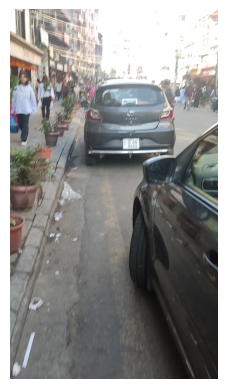


0: 640x384 (no detections), 46.4ms
Speed: 5.0ms preprocess, 46.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


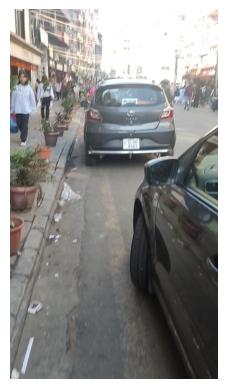


0: 640x384 (no detections), 46.3ms
Speed: 4.1ms preprocess, 46.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


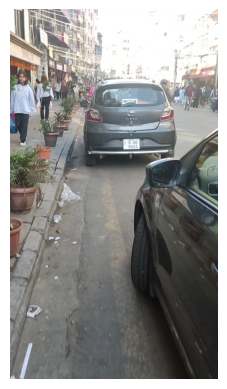


0: 640x384 (no detections), 45.3ms
Speed: 5.5ms preprocess, 45.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 384)


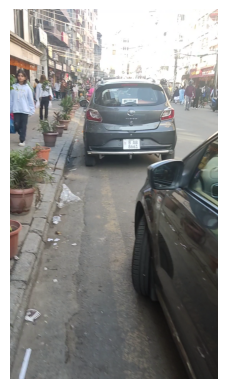


0: 640x384 (no detections), 46.4ms
Speed: 4.5ms preprocess, 46.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


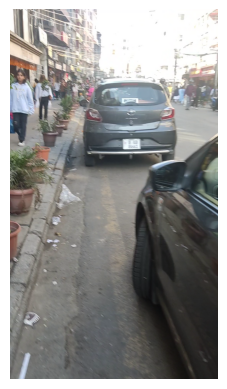


0: 640x384 (no detections), 46.6ms
Speed: 4.9ms preprocess, 46.6ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


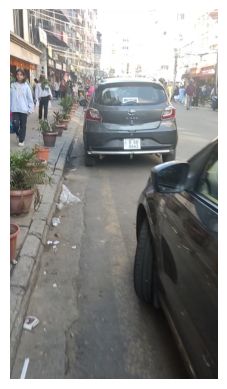


0: 640x384 (no detections), 46.1ms
Speed: 3.7ms preprocess, 46.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


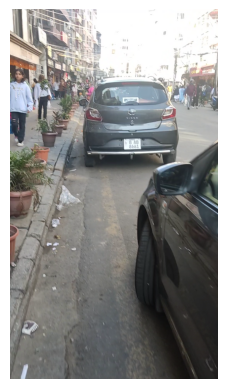


0: 640x384 (no detections), 45.7ms
Speed: 3.8ms preprocess, 45.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


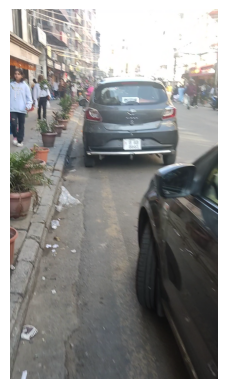


0: 640x384 (no detections), 46.0ms
Speed: 6.0ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


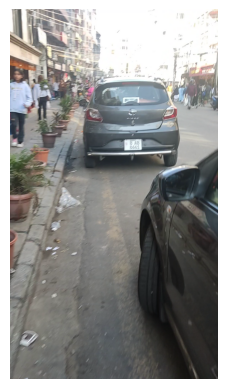


0: 640x384 1 number plate, 45.6ms
Speed: 4.1ms preprocess, 45.6ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)


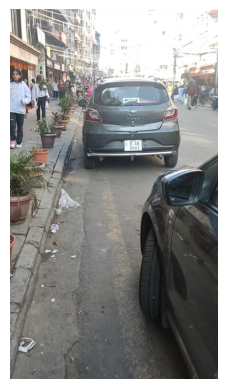


0: 640x384 (no detections), 46.1ms
Speed: 4.5ms preprocess, 46.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


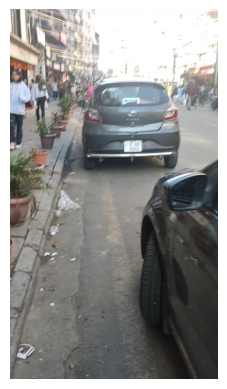


0: 640x384 (no detections), 46.7ms
Speed: 5.1ms preprocess, 46.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


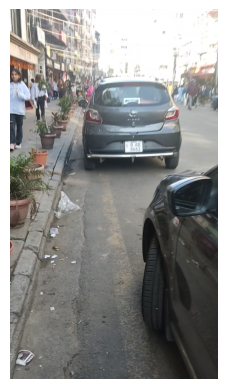


0: 640x384 (no detections), 46.1ms
Speed: 4.7ms preprocess, 46.1ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 384)


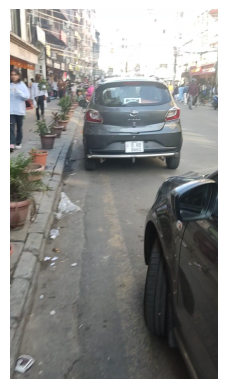


0: 640x384 (no detections), 46.3ms
Speed: 3.2ms preprocess, 46.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


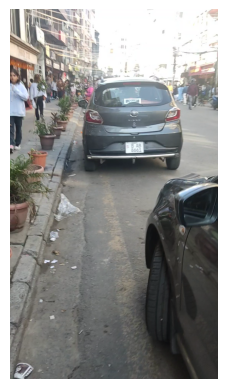


0: 640x384 (no detections), 46.0ms
Speed: 5.5ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


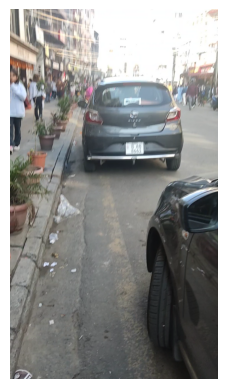


0: 640x384 (no detections), 46.0ms
Speed: 5.0ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


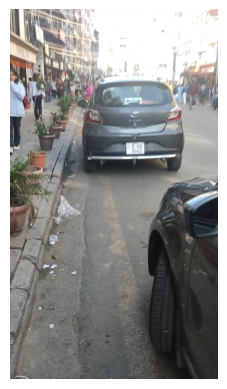


0: 640x384 (no detections), 45.7ms
Speed: 4.0ms preprocess, 45.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


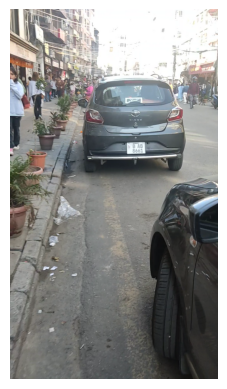


0: 640x384 (no detections), 45.9ms
Speed: 5.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


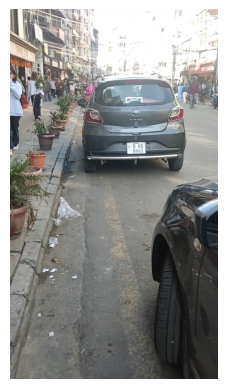


0: 640x384 (no detections), 46.5ms
Speed: 3.9ms preprocess, 46.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 384)


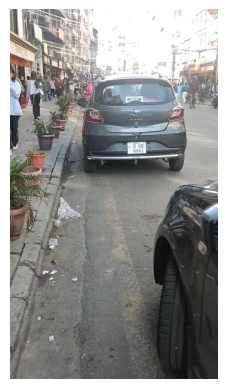


0: 640x384 (no detections), 46.1ms
Speed: 6.4ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


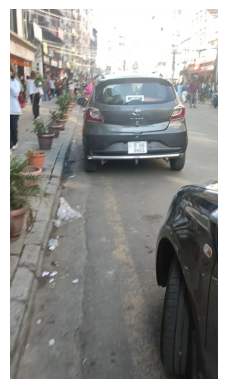


0: 640x384 (no detections), 46.4ms
Speed: 4.6ms preprocess, 46.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


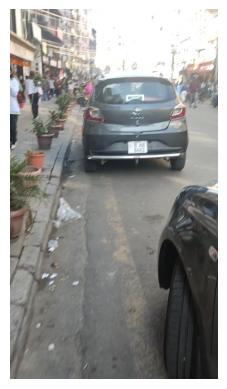


0: 640x384 (no detections), 46.3ms
Speed: 5.8ms preprocess, 46.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


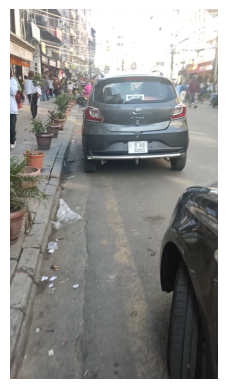


0: 640x384 (no detections), 46.7ms
Speed: 4.4ms preprocess, 46.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


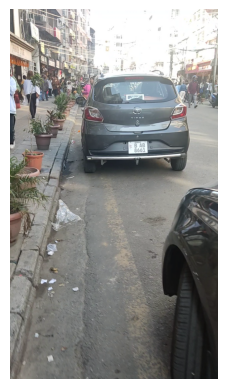


0: 640x384 (no detections), 45.9ms
Speed: 5.2ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


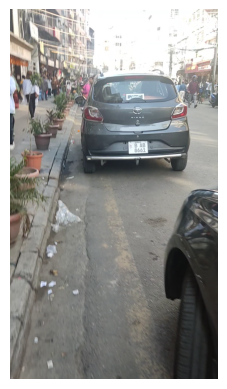


0: 640x384 (no detections), 45.9ms
Speed: 4.7ms preprocess, 45.9ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 384)


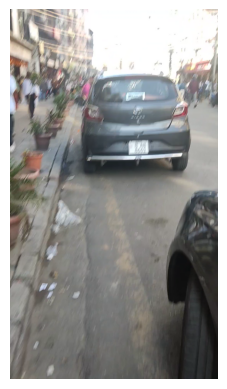


0: 640x384 (no detections), 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


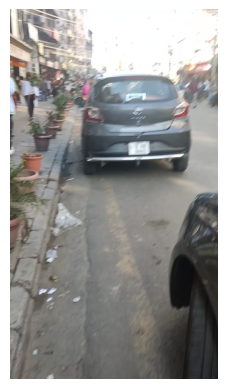


0: 640x384 (no detections), 45.9ms
Speed: 5.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


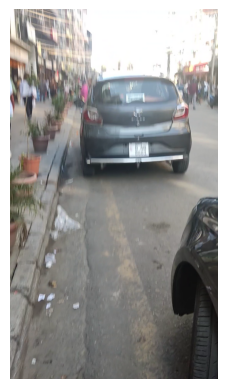


0: 640x384 (no detections), 45.9ms
Speed: 5.4ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


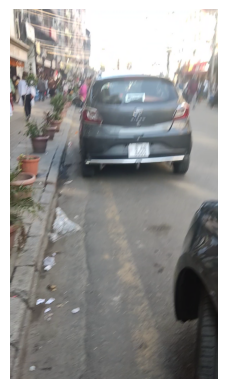


0: 640x384 (no detections), 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


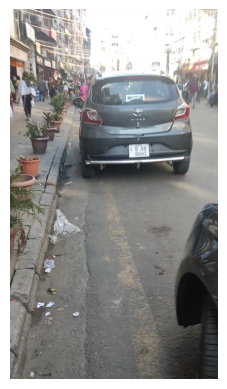


0: 640x384 (no detections), 46.0ms
Speed: 4.5ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


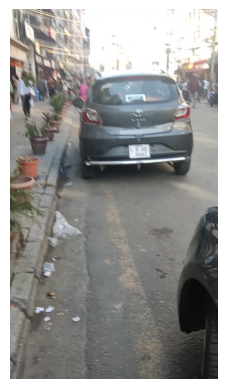


0: 640x384 1 number plate, 45.9ms
Speed: 4.1ms preprocess, 45.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


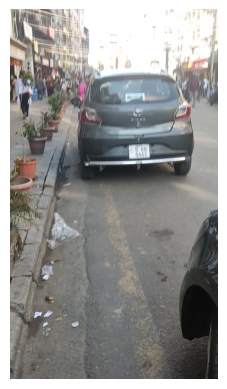


0: 640x384 (no detections), 46.2ms
Speed: 5.4ms preprocess, 46.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


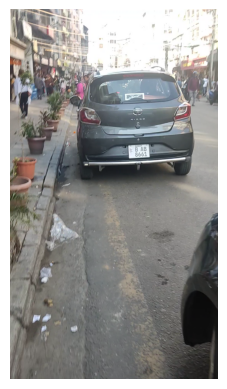


0: 640x384 (no detections), 45.9ms
Speed: 7.0ms preprocess, 45.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


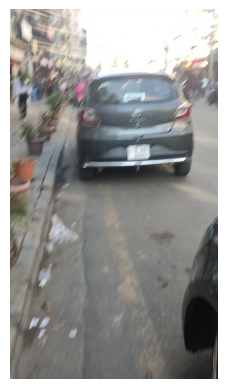


0: 640x384 (no detections), 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


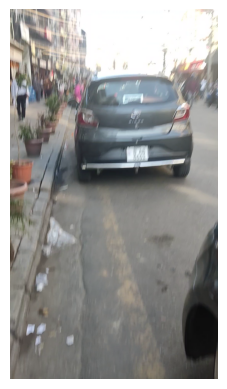


0: 640x384 (no detections), 46.5ms
Speed: 4.8ms preprocess, 46.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


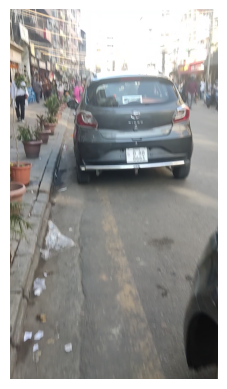


0: 640x384 (no detections), 45.9ms
Speed: 4.2ms preprocess, 45.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


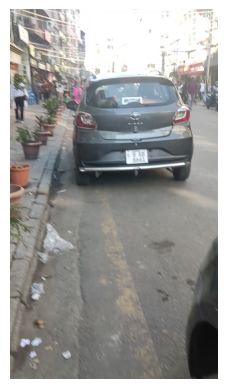


0: 640x384 (no detections), 46.0ms
Speed: 3.5ms preprocess, 46.0ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


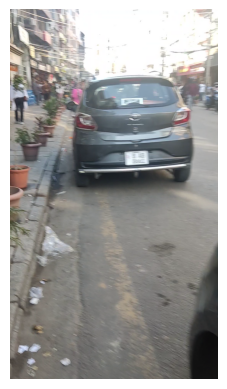


0: 640x384 (no detections), 46.5ms
Speed: 4.3ms preprocess, 46.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


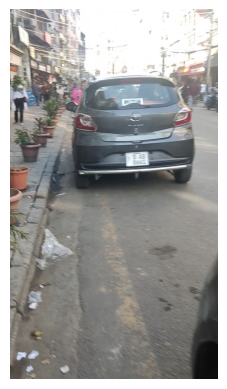


0: 640x384 (no detections), 46.9ms
Speed: 3.4ms preprocess, 46.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


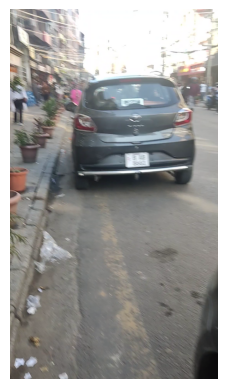


0: 640x384 (no detections), 46.1ms
Speed: 4.2ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


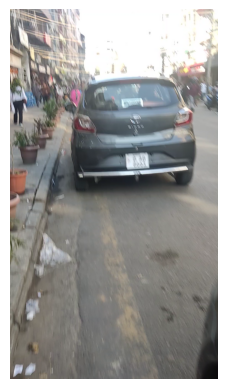


0: 640x384 (no detections), 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


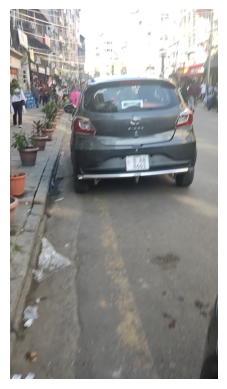


0: 640x384 (no detections), 45.2ms
Speed: 5.3ms preprocess, 45.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


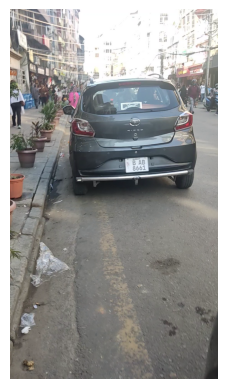


0: 640x384 (no detections), 46.0ms
Speed: 5.0ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


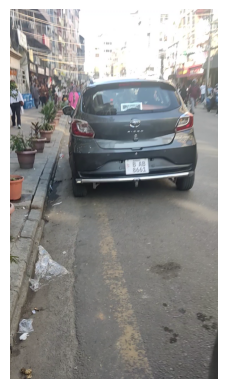


0: 640x384 (no detections), 45.1ms
Speed: 4.8ms preprocess, 45.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


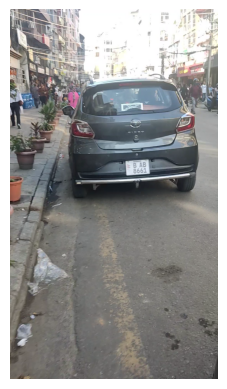


0: 640x384 (no detections), 45.9ms
Speed: 4.4ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


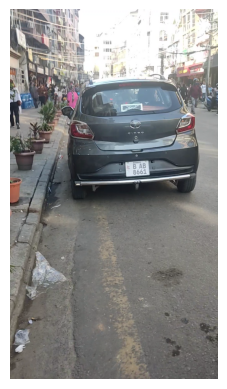


0: 640x384 (no detections), 46.0ms
Speed: 4.5ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


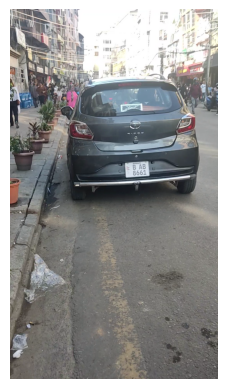


0: 640x384 (no detections), 46.8ms
Speed: 3.5ms preprocess, 46.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


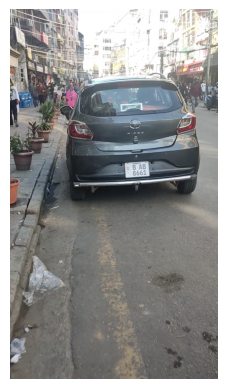


0: 640x384 (no detections), 46.1ms
Speed: 4.1ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


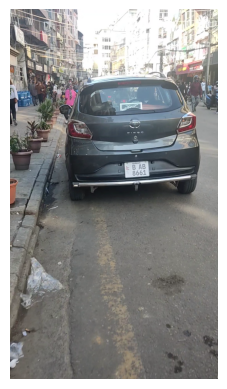


0: 640x384 (no detections), 46.0ms
Speed: 4.5ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


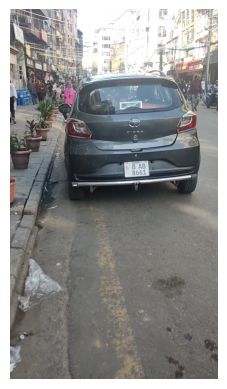


0: 640x384 (no detections), 46.0ms
Speed: 4.4ms preprocess, 46.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


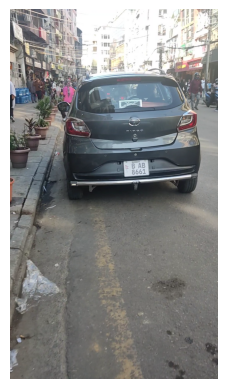


0: 640x384 (no detections), 46.7ms
Speed: 4.1ms preprocess, 46.7ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 384)


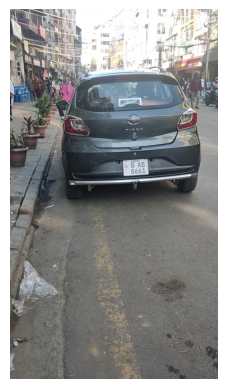


0: 640x384 (no detections), 45.9ms
Speed: 5.5ms preprocess, 45.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)


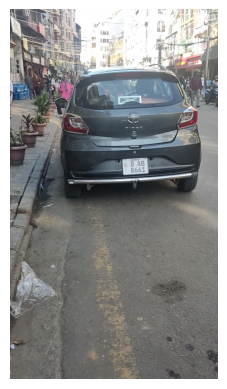


0: 640x384 (no detections), 45.9ms
Speed: 4.2ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


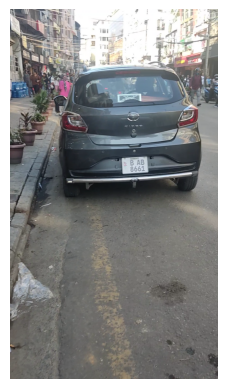


0: 640x384 (no detections), 46.3ms
Speed: 3.6ms preprocess, 46.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)


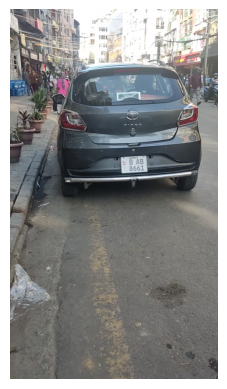


0: 640x384 (no detections), 46.3ms
Speed: 3.1ms preprocess, 46.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


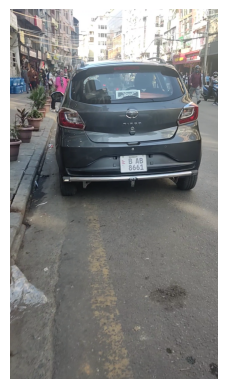


0: 640x384 (no detections), 46.4ms
Speed: 4.0ms preprocess, 46.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


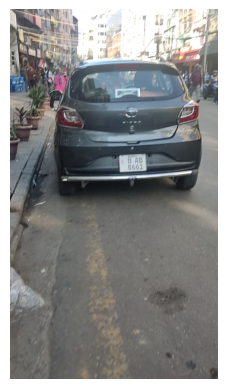


0: 640x384 (no detections), 45.5ms
Speed: 4.2ms preprocess, 45.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 384)


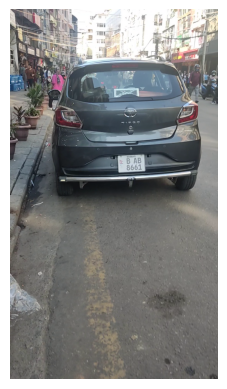


0: 640x384 (no detections), 47.0ms
Speed: 7.0ms preprocess, 47.0ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 384)


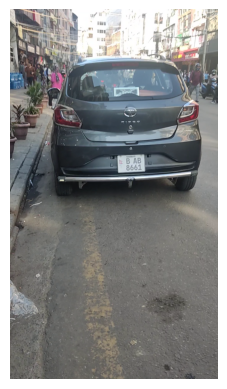


0: 640x384 (no detections), 45.9ms
Speed: 4.0ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


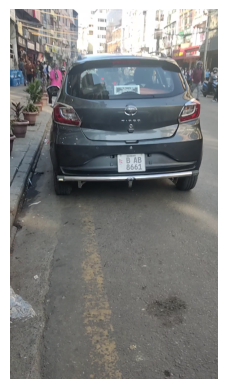


0: 640x384 (no detections), 46.1ms
Speed: 4.0ms preprocess, 46.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


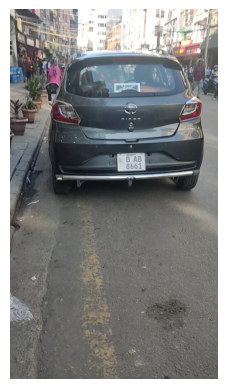


0: 640x384 (no detections), 46.3ms
Speed: 5.0ms preprocess, 46.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


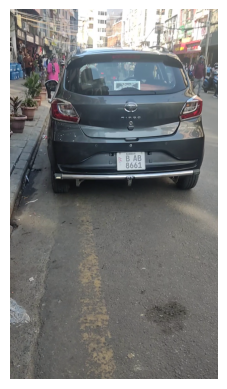


0: 640x384 (no detections), 45.9ms
Speed: 4.6ms preprocess, 45.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


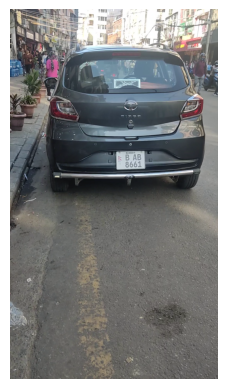


0: 640x384 (no detections), 45.8ms
Speed: 4.3ms preprocess, 45.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)


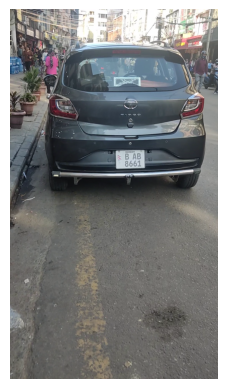

End of video stream or error reading frame.


<Figure size 640x480 with 0 Axes>

In [2]:
import cv2
from ultralytics import YOLO
import matplotlib.pyplot as plt

CONFIDENCE_THRESHOLD = 0.6
COLOR = (0, 255, 0)
DETECTION_LABEL = "Number Plate"

def detect_number_plate(image, model):
    detections = model.predict(image)[0].boxes.data
    for detection in detections:
        confidence = detection[4].item()
        if confidence >= CONFIDENCE_THRESHOLD:
            xmin, ymin, xmax, ymax = map(int, detection[:4])
            cv2.rectangle(image, (xmin, ymin), (xmax, ymax), COLOR, 2)
            text = f"{DETECTION_LABEL}: {confidence * 100:.2f}%"
            cv2.putText(image, text, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, COLOR, 2)

def process_video(video_source, model):
    cap = cv2.VideoCapture(video_source)
    if not cap.isOpened():
        print("Error: Could not open video source.")
        return

    while True:
        ret, frame = cap.read()
        if not ret:
            print("End of video stream or error reading frame.")
            break

        detect_number_plate(frame, model)

        # Convert BGR to RGB for matplotlib
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        plt.imshow(frame_rgb)
        plt.axis('off')  # Hide axes
        plt.pause(0.01)  # Small delay to mimic frame rate
        plt.clf()  # Clear figure for the next frame

    cap.release()

if __name__ == "__main__":
    model = YOLO("C:\\Users\\Acer nitro 5\\number\\code\\runs\\detect\\train\\weights\\best.pt")
    video_source = r"C:\\Users\\Acer nitro 5\\number\\datasets\\video\\vid2.mp4"
    process_video(video_source, model)


In [2]:
pip install opencv-python-headless


Note: you may need to restart the kernel to use updated packages.


In [6]:
import cv2
from ultralytics import YOLO
from IPython.display import display
import ipywidgets as widgets
from time import sleep
import torch  # Assuming segmentation model uses PyTorch

# Constants
CONFIDENCE_THRESHOLD = 0.6
CHARACTER_CONFIDENCE_THRESHOLD = 0.3
COLOR = (0, 255, 0)  # Color for number plate box
DETECTION_LABEL = "Number Plate"
CHARACTER_COLOR = (0, 0, 255)  # Color for character segmentation boxes
CHARACTER_BG_COLOR = (0, 0, 0)  # Background color for character text

# Define the detection function
def detect_number_plate(image, model, char_segmentation_model):
    # Run the main model to detect number plates
    detections = model.predict(image)[0].boxes.data
    for detection in detections:
        confidence = detection[4].item()
        if confidence >= CONFIDENCE_THRESHOLD:
            # Draw bounding box around detected number plate
            xmin, ymin, xmax, ymax = map(int, detection[:4])
            cv2.rectangle(image, (xmin, ymin), (xmax, ymax), COLOR, 2)
            text = f"{DETECTION_LABEL}: {confidence * 100:.2f}%"
            cv2.putText(image, text, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, COLOR, 2)

            # Crop the number plate region for character segmentation
            number_plate = image[ymin:ymax, xmin:xmax]

            # Run character segmentation model on the cropped number plate
            char_detections = char_segmentation_model.predict(number_plate)[0].boxes.data
            
            for char_detection in char_detections:
                char_confidence = char_detection[4].item()
                if char_confidence >= CHARACTER_CONFIDENCE_THRESHOLD:
                    # Get character bounding box coordinates
                    char_xmin, char_ymin, char_xmax, char_ymax = map(int, char_detection[:4])
                    
                    # Adjust coordinates to fit within the original image
                    char_xmin += xmin
                    char_ymin += ymin
                    char_xmax += xmin
                    char_ymax += ymin

                    # Draw bounding box for each detected character
                    cv2.rectangle(image, (char_xmin, char_ymin), (char_xmax, char_ymax), CHARACTER_COLOR, 2)
                    
                    # Draw a filled rectangle for text background
                    text_bg_xmin = char_xmin
                    text_bg_ymin = char_ymin - 15 if char_ymin - 15 > 0 else char_ymin + 15
                    cv2.rectangle(image, (text_bg_xmin, text_bg_ymin - 10), (char_xmax, text_bg_ymin), CHARACTER_BG_COLOR, -1)

                    # Display character confidence above the bounding box
                    char_text = f"{char_confidence * 100:.2f}%"
                    cv2.putText(image, char_text, (char_xmin, text_bg_ymin - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.4, CHARACTER_COLOR, 1)


# Define the video processing function with widget updates
def process_video(video_source, model, char_segmentation_model):
    # Open video source
    cap = cv2.VideoCapture(video_source)
    if not cap.isOpened():
        print("Error: Could not open video source.")
        return

    # Create an output widget for smoother updates
    output_widget = widgets.Output()
    display(output_widget)

    # Create an Image widget to hold frames
    image_widget = widgets.Image()
    display(image_widget)

    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                print("End of video stream or error reading frame.")
                break

            # Run detection on the current frame
            detect_number_plate(frame, model, char_segmentation_model)

            # Convert the frame to JPEG format for display
            _, buffer = cv2.imencode('.jpg', frame)
            image_widget.value = buffer.tobytes()

            # Speed up video by reducing sleep time
            sleep(0.001)  # Adjusted for faster playback speed

    except KeyboardInterrupt:
        print("Video display interrupted.")

    finally:
        cap.release()

if __name__ == "__main__":
    # Load YOLO model for number plate detection
    model = YOLO("C:\\Users\\Acer nitro 5\\number\\code\\runs\\detect\\train\\weights\\best.pt")
    
    # Load character segmentation model (assuming it's also a YOLO model or compatible with the predict method)
    char_segmentation_model = YOLO(r"C:\Users\Acer nitro 5\number\segment\runs\detect\train3\weights\best.pt")
    
    # Choose video source (0 for webcam or video file path)
    video_source = r"C:\\Users\\Acer nitro 5\\number\\datasets\\video\\vid2.mp4"
    
    # Process video and display in Jupyter Notebook
    process_video(video_source, model, char_segmentation_model)

Output()

Image(value=b'')


0: 640x384 1 number plate, 88.4ms
Speed: 59.0ms preprocess, 88.4ms inference, 1441.1ms postprocess per image at shape (1, 3, 640, 384)

0: 512x640 (no detections), 60.1ms
Speed: 4.7ms preprocess, 60.1ms inference, 0.0ms postprocess per image at shape (1, 3, 512, 640)

0: 640x384 1 number plate, 42.4ms
Speed: 4.4ms preprocess, 42.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)

0: 480x640 (no detections), 59.1ms
Speed: 4.3ms preprocess, 59.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)

0: 640x384 1 number plate, 42.2ms
Speed: 5.6ms preprocess, 42.2ms inference, 3.2ms postprocess per image at shape (1, 3, 640, 384)

0: 448x640 (no detections), 60.8ms
Speed: 4.3ms preprocess, 60.8ms inference, 1.0ms postprocess per image at shape (1, 3, 448, 640)

0: 640x384 1 number plate, 20.3ms
Speed: 4.0ms preprocess, 20.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)

0: 480x640 (no detections), 24.9ms
Speed: 3.2ms preprocess, 24.9ms i

In [3]:
!pip install ipywidgets


   ---------------------------------------- 0.0/2.3 MB ? eta -:--:--
   -------- ------------------------------- 0.5/2.3 MB 2.8 MB/s eta 0:00:01
   ----------------- ---------------------- 1.0/2.3 MB 2.4 MB/s eta 0:00:01
   -------------------------- ------------- 1.6/2.3 MB 2.5 MB/s eta 0:00:01
   ----------------------------------- ---- 2.1/2.3 MB 2.6 MB/s eta 0:00:01
   ---------------------------------------- 2.3/2.3 MB 2.4 MB/s eta 0:00:00
